In [1]:
!pip install tensorflow

In [2]:
from zipfile import ZipFile
dataset = '/content/drive/MyDrive/archive (1).zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [3]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [4]:
BASE_DIR='/content/images'

In [5]:
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [6]:
image_paths[:5]

['/content/images/55717_2016.jpg',
 '/content/images/47554_2014.jpg',
 '/content/images/58250_2017.jpg',
 '/content/images/16267_2006.jpg',
 '/content/images/27982_2009.jpg']

In [7]:
len(image_paths)

63565

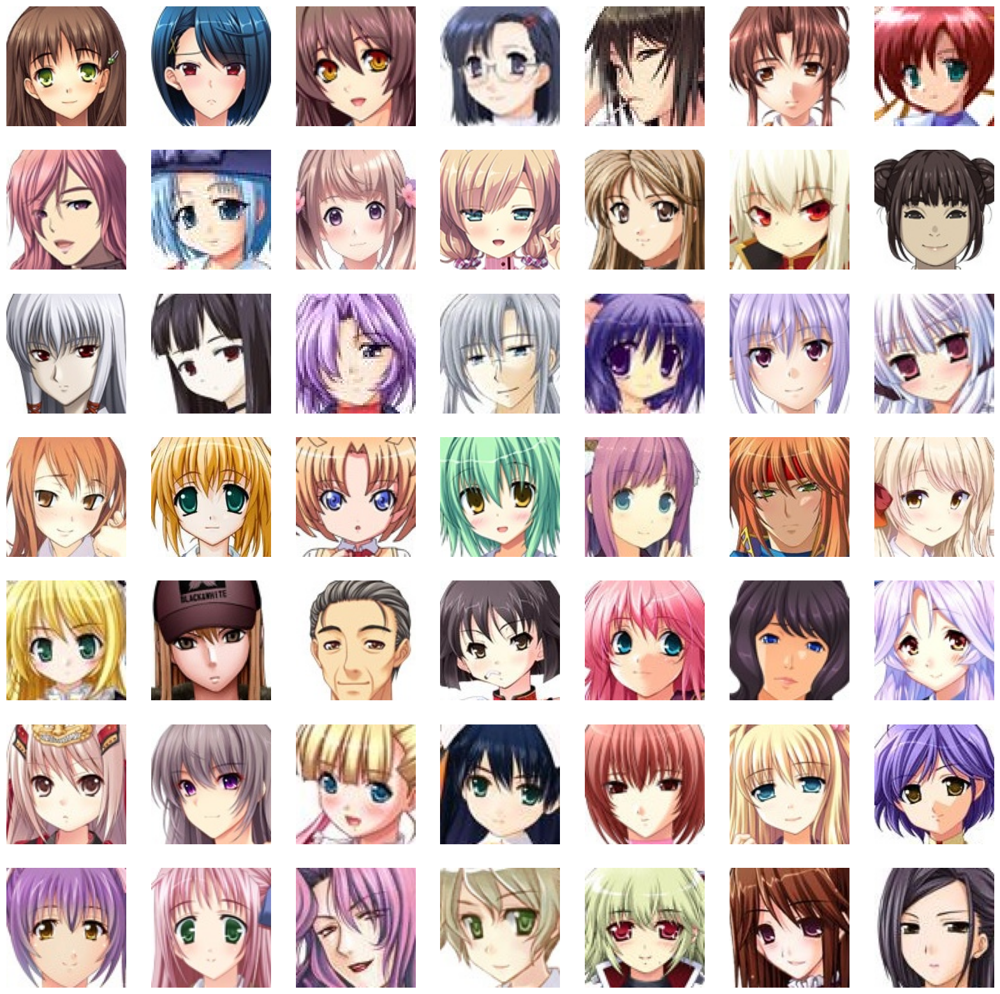

In [8]:
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

In [9]:
import cv2

train_images = [cv2.resize(cv2.imread(path), (64, 64)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/63565 [00:00<?, ?it/s]

In [10]:
train_images[0].shape

(64, 64, 3)

In [11]:
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [12]:
train_images = (train_images - 127.5) / 127.5

In [13]:
train_images[0]

array([[[ 1.        ,  1.        ,  0.99215686],
        [ 1.        ,  0.9843137 ,  1.        ],
        [ 0.9843137 ,  0.99215686,  1.        ],
        ...,
        [ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ]],

       [[ 1.        ,  1.        ,  0.99215686],
        [ 1.        ,  1.        ,  1.        ],
        [ 0.9843137 ,  1.        ,  1.        ],
        ...,
        [ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ]],

       [[ 1.        ,  1.        ,  0.99215686],
        [ 1.        ,  1.        ,  0.99215686],
        [ 0.9843137 ,  1.        ,  0.99215686],
        ...,
        [ 1.        ,  1.        ,  0.99215686],
        [ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ]],

       ...,

       [[-0.39607844, -0.3254902 , -0.05882353],
        [-0

In [14]:
LATENT_DIM = 100
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
CHANNELS = 3 # for gray scale, keep it as 1

In [15]:
model = Sequential(name='generator')


model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
model.add(layers.ReLU())


model.add(layers.Reshape((8, 8, 512)))


model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())


model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())


model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

In [16]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2


model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))


model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

In [17]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):

        batch_size = tf.shape(real_images)[0]

        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))


        with tf.GradientTape() as tape:

            pred_real = self.discriminator(real_images, training=True)

            real_labels = tf.ones((batch_size, 1))

            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)


            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)

            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)


            d_loss = (d_loss_real + d_loss_fake) / 2


        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)

        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))



        labels = tf.ones((batch_size, 1))

        with tf.GradientTape() as tape:

            fake_images = self.generator(random_noise, training=True)

            pred_fake = self.discriminator(fake_images, training=True)

            g_loss = self.loss_fn(labels, pred_fake)


        gradients = tape.gradient(g_loss, self.generator.trainable_variables)

        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))


        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}


In [18]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim

        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):

        g_img = self.model.generator(self.noise)

        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')

        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [19]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim

        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):

        g_img = self.model.generator(self.noise)

        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        plt.show()


        return logs if logs is not None else {}

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

        return logs if logs is not None else {}

In [20]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [21]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())


In [22]:
# Before running your code, check if 'zip' is a built-in function
import builtins
if not isinstance(builtins.zip, type(zip)):
    # If 'zip' is not the built-in function, restore it
    zip = builtins.zip
    print("Warning: 'zip' was overwritten. Restored to built-in function.")

Epoch 1/50
1987/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.8560 - g_loss: 2.1697

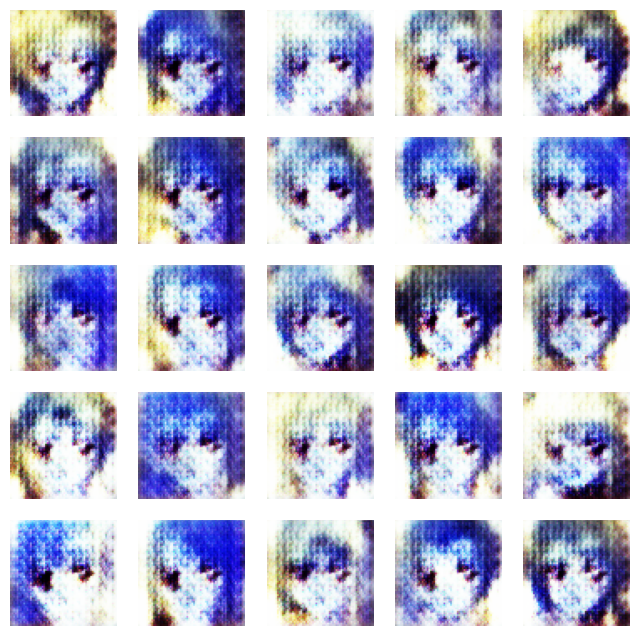

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 152s 66ms/step - d_loss: 0.8559 - g_loss: 2.1697
Epoch 2/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6397 - g_loss: 1.4805

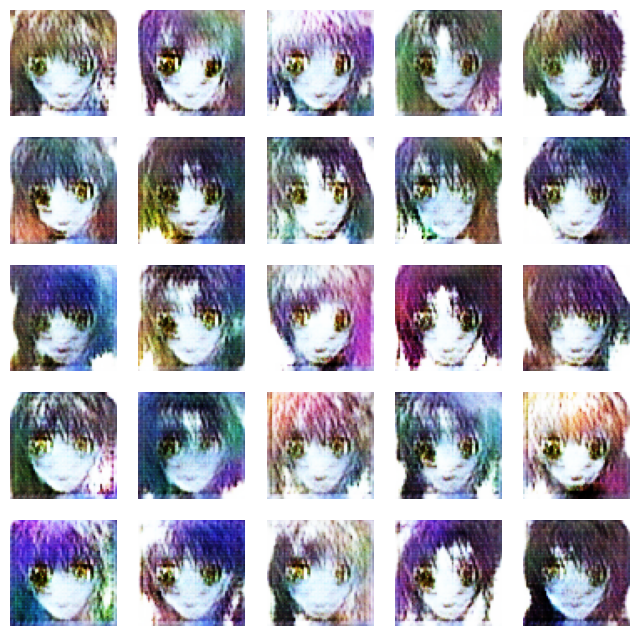

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 180s 62ms/step - d_loss: 0.6397 - g_loss: 1.4805
Epoch 3/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6736 - g_loss: 1.2051

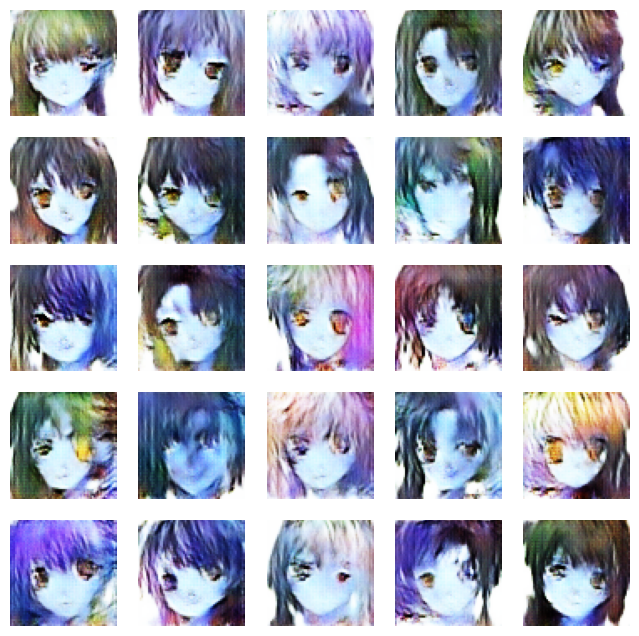

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.6736 - g_loss: 1.2050
Epoch 4/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6976 - g_loss: 0.9590

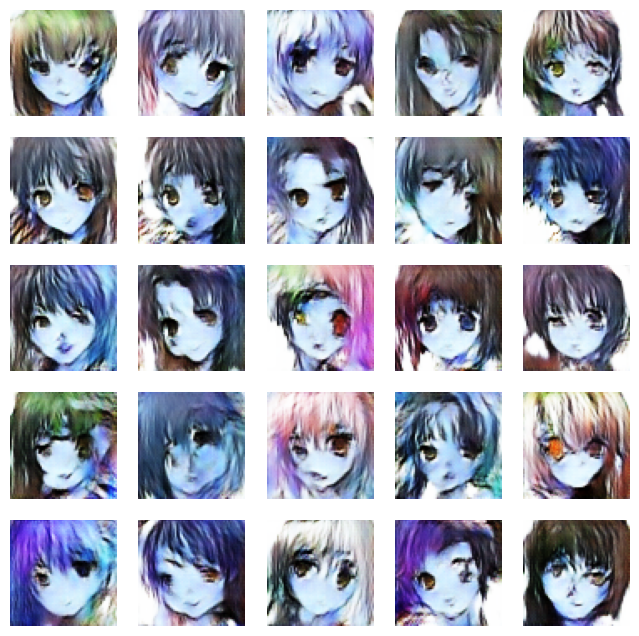

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.6976 - g_loss: 0.9589
Epoch 5/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7094 - g_loss: 0.8309

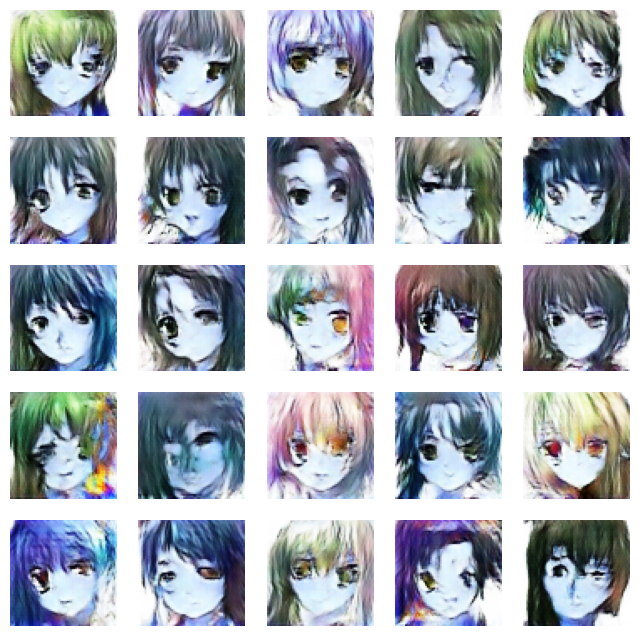

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.7094 - g_loss: 0.8309
Epoch 6/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7114 - g_loss: 0.7712

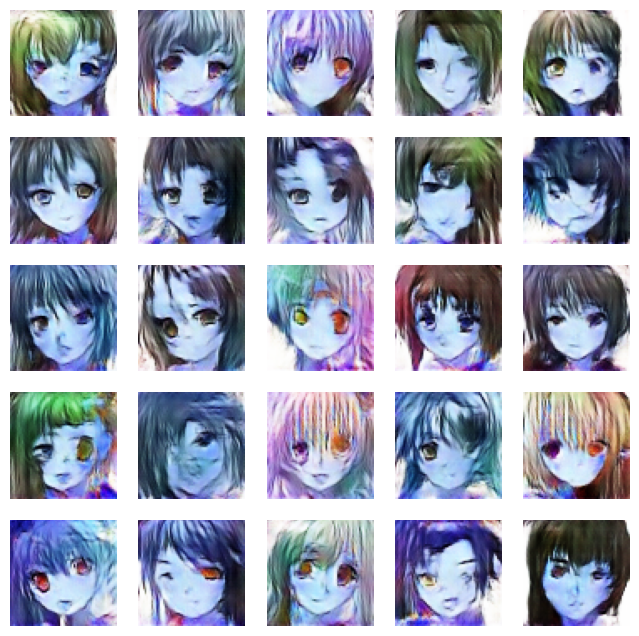

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 124s 62ms/step - d_loss: 0.7114 - g_loss: 0.7711
Epoch 7/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7088 - g_loss: 0.7392

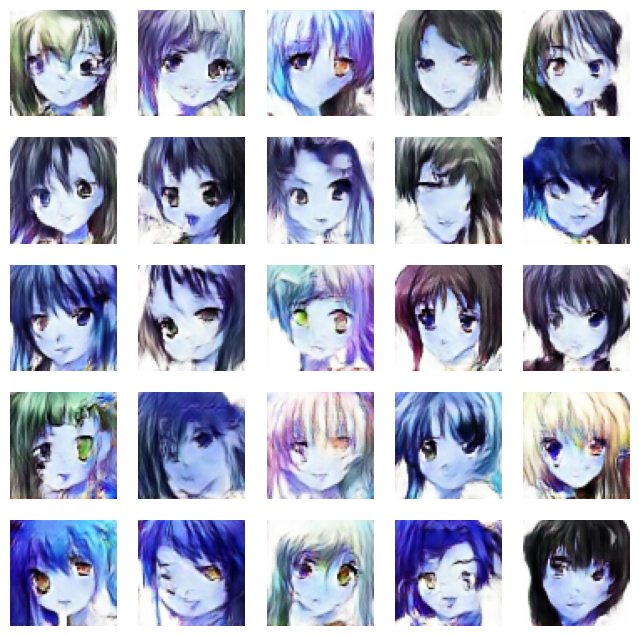

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 63ms/step - d_loss: 0.7088 - g_loss: 0.7392
Epoch 8/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7055 - g_loss: 0.7293

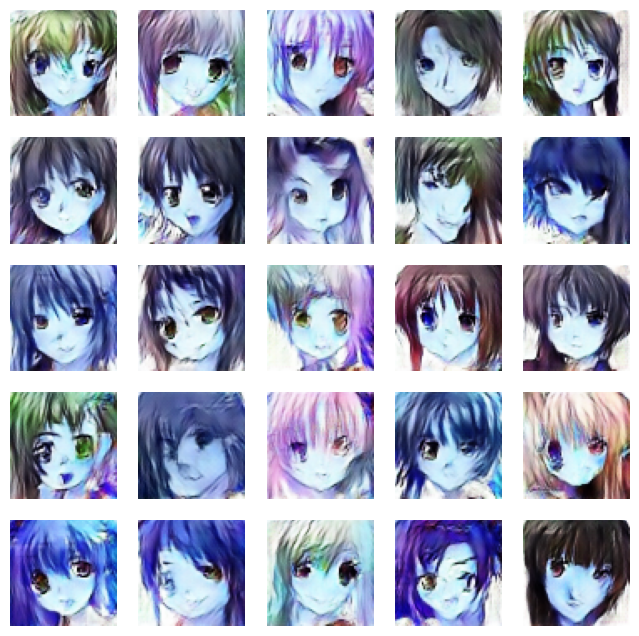

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 124s 62ms/step - d_loss: 0.7055 - g_loss: 0.7293
Epoch 9/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7014 - g_loss: 0.7273

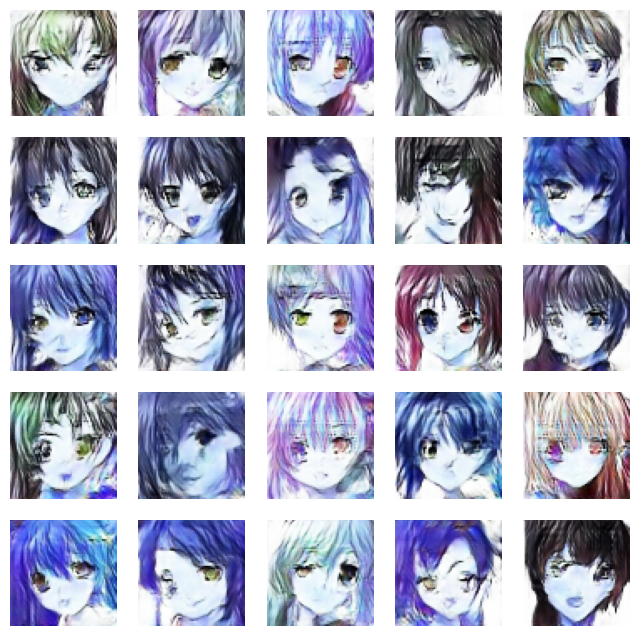

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.7014 - g_loss: 0.7273
Epoch 10/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6970 - g_loss: 0.7406

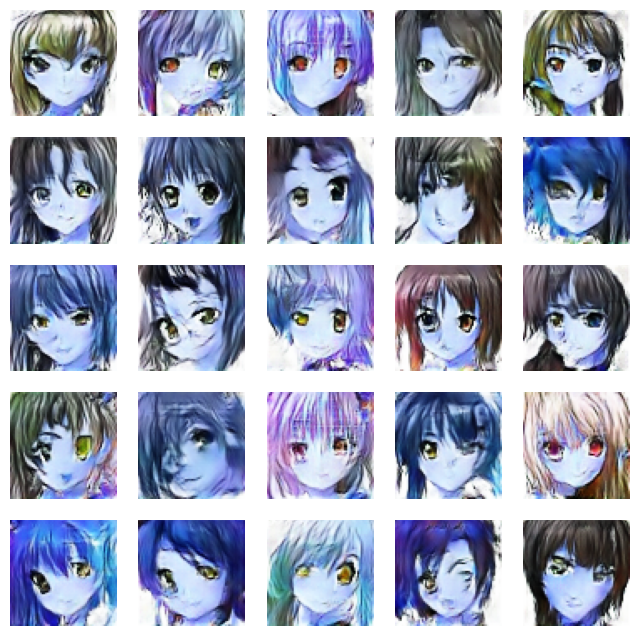

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 141s 62ms/step - d_loss: 0.6970 - g_loss: 0.7406
Epoch 11/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6919 - g_loss: 0.7515

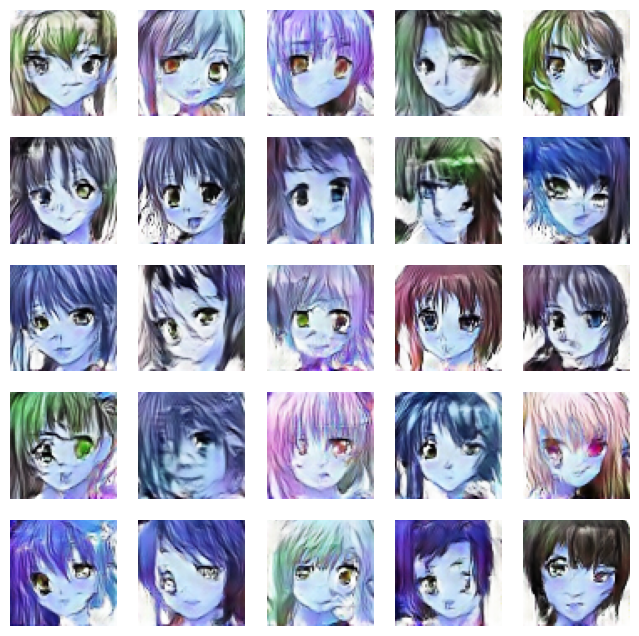

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 124s 62ms/step - d_loss: 0.6919 - g_loss: 0.7515
Epoch 12/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6854 - g_loss: 0.7688

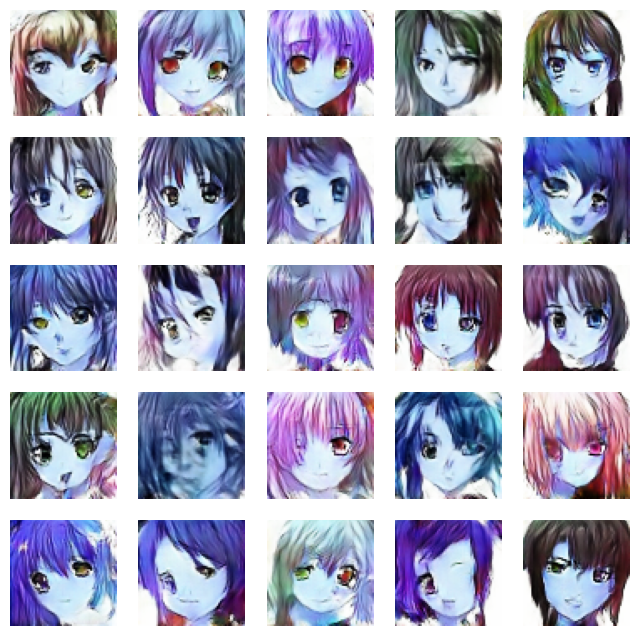

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.6854 - g_loss: 0.7688
Epoch 13/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6800 - g_loss: 0.7905

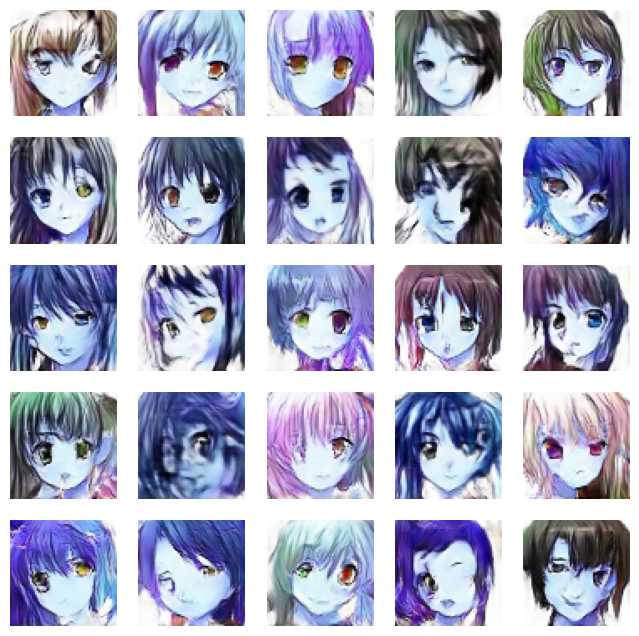

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.6799 - g_loss: 0.7905
Epoch 14/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6712 - g_loss: 0.8157

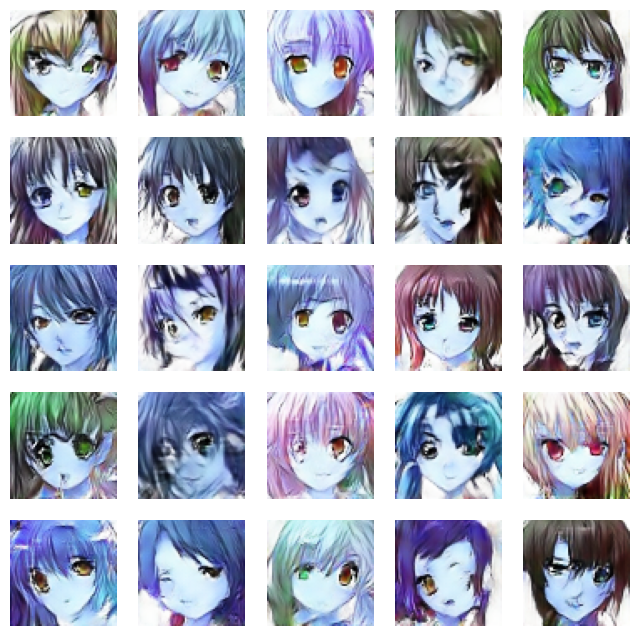

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 123s 62ms/step - d_loss: 0.6712 - g_loss: 0.8157
Epoch 15/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6661 - g_loss: 0.8348

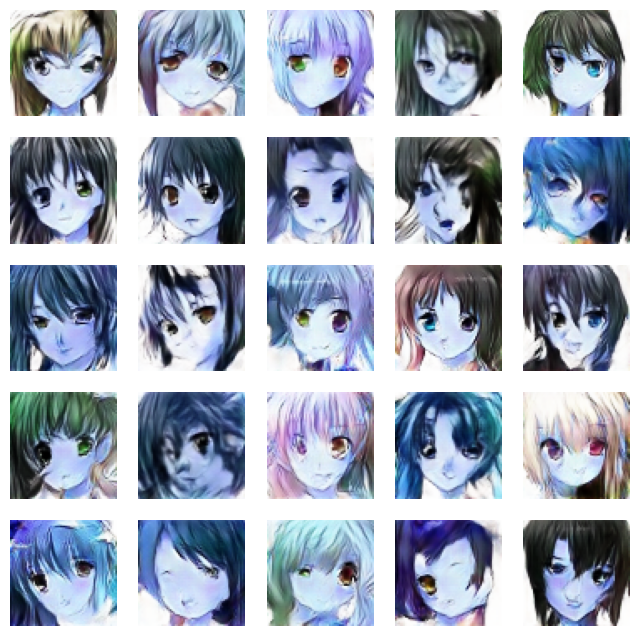

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 123s 62ms/step - d_loss: 0.6661 - g_loss: 0.8348
Epoch 16/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6608 - g_loss: 0.8572

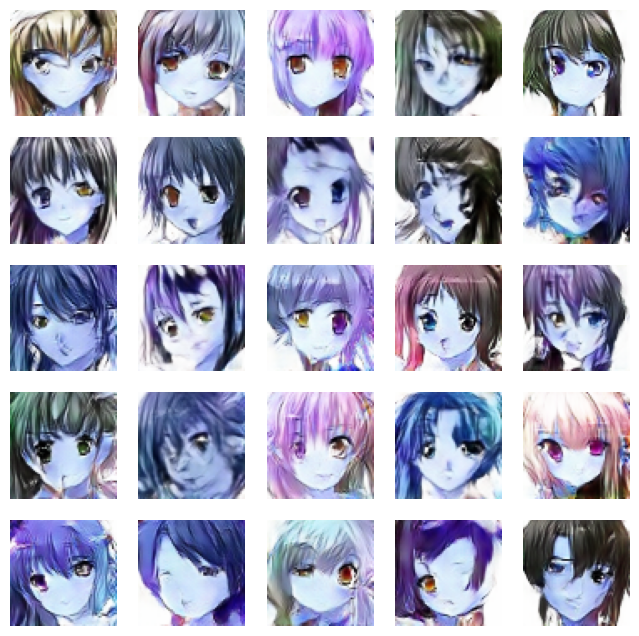

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.6608 - g_loss: 0.8572
Epoch 17/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6541 - g_loss: 0.8786

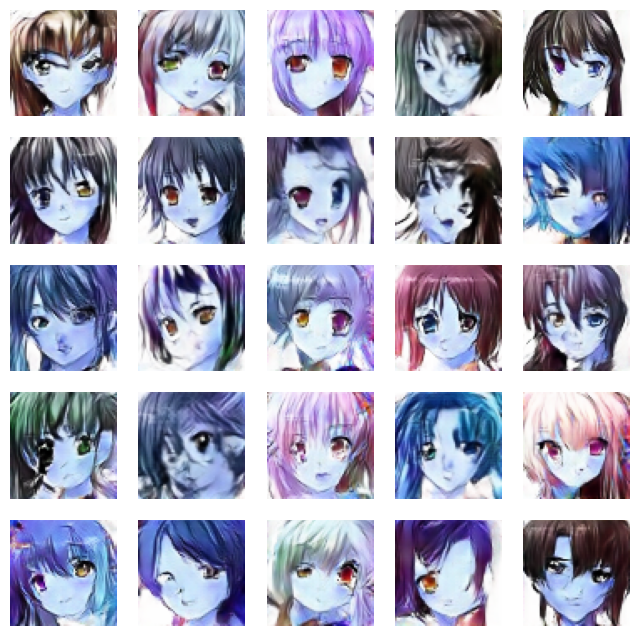

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 123s 62ms/step - d_loss: 0.6541 - g_loss: 0.8786
Epoch 18/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6490 - g_loss: 0.8952

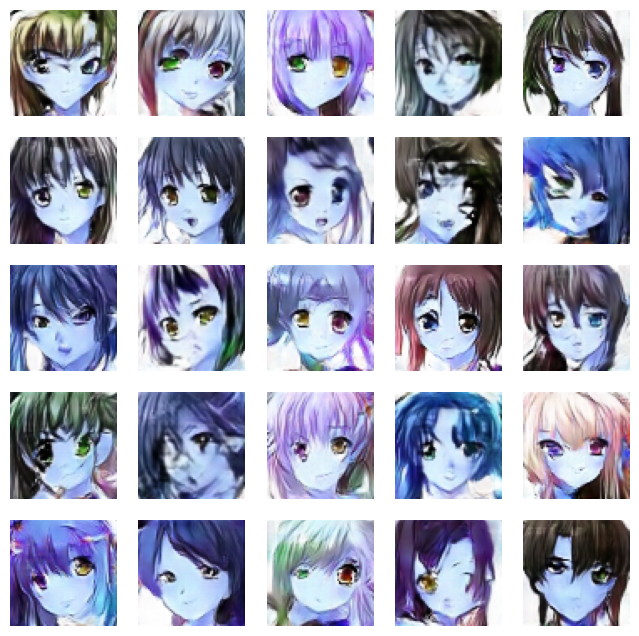

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.6490 - g_loss: 0.8952
Epoch 19/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6423 - g_loss: 0.9193

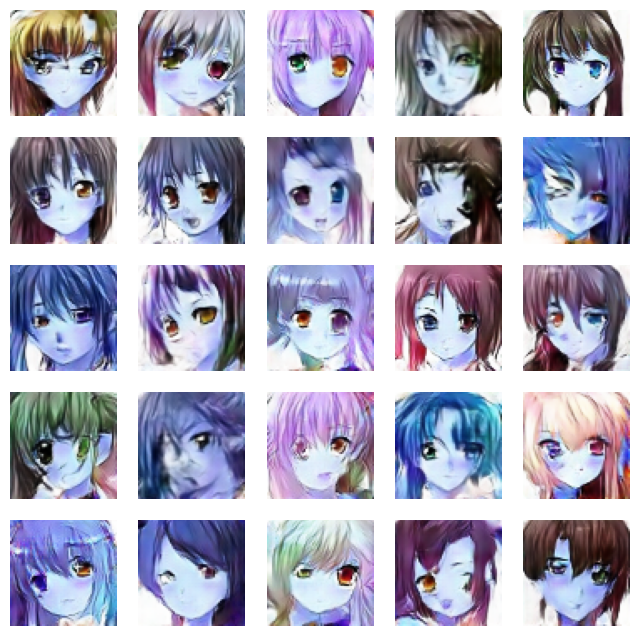

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 123s 62ms/step - d_loss: 0.6423 - g_loss: 0.9193
Epoch 20/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6393 - g_loss: 0.9445

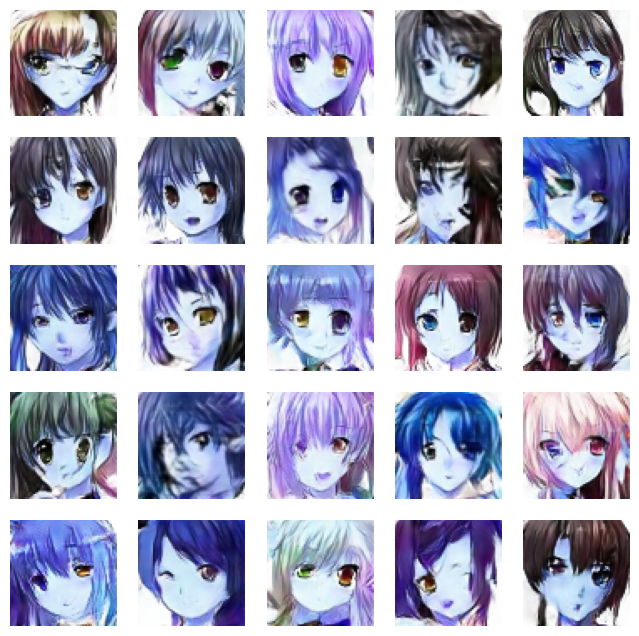

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.6393 - g_loss: 0.9445
Epoch 21/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6295 - g_loss: 0.9641

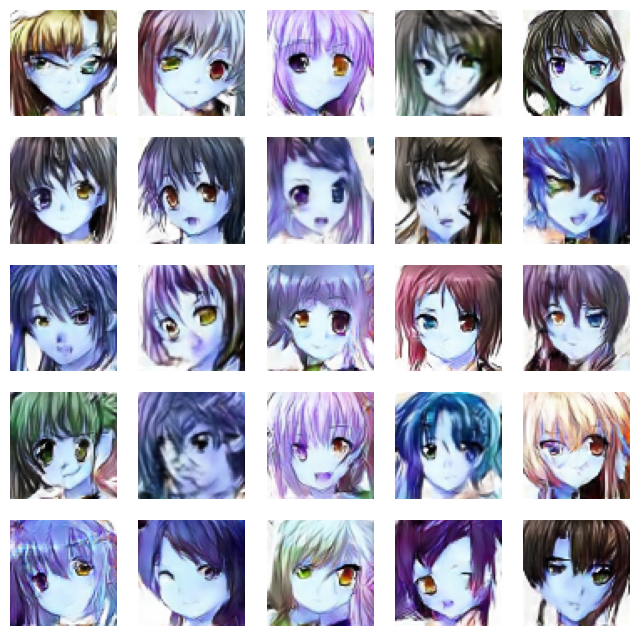

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 142s 62ms/step - d_loss: 0.6295 - g_loss: 0.9641
Epoch 22/50
1986/1987 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6254 - g_loss: 0.9895

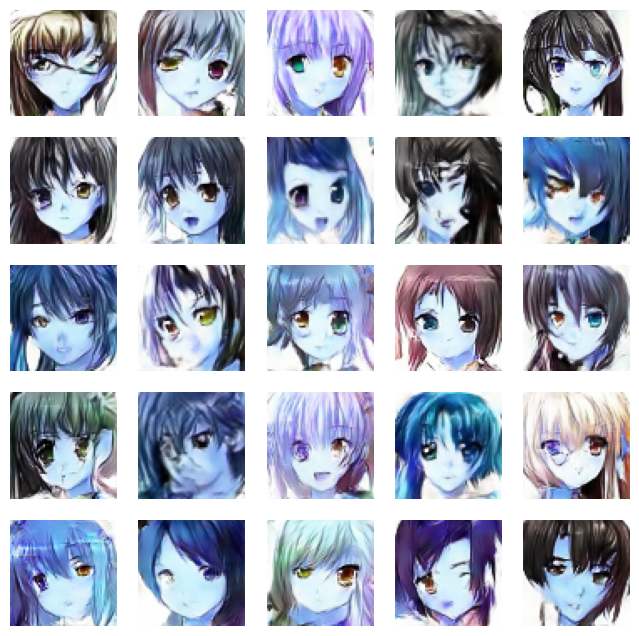

1987/1987 ━━━━━━━━━━━━━━━━━━━━ 123s 62ms/step - d_loss: 0.6254 - g_loss: 0.9895
Epoch 23/50
 136/1987 ━━━━━━━━━━━━━━━━━━━━ 1:54 62ms/step - d_loss: 0.6128 - g_loss: 0.9960

In [ ]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])


In [ ]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
g_img = dcgan.generator(noise)
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()